<a href="https://colab.research.google.com/github/Jyotirmoy-99/ASTRO/blob/main/Galactic_Orbit_Simulation_M67_vs_Sun_using_GAIA_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

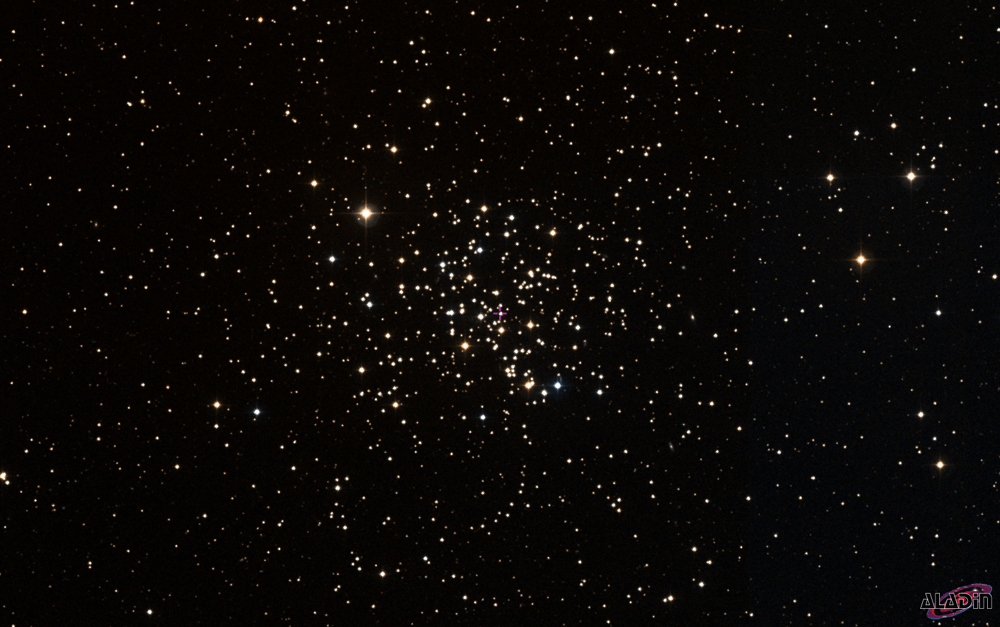

# Galactic Orbit Analysis of M67 and the Sun using GAIA Data
This notebook aims to simulate and analyze the galactic orbits of the open cluster M67 and the Sun using 6D phase-space data obtained from GAIA. By integrating their orbits in the Milky Way's gravitational potential, we aim to explore their orbital dynamics and potential proximity through cosmic history.

# Problem Definition

Objective:
Simulate and visualize the galactic orbits of the open cluster M67 and the Sun
using 6D phase-space data. Understand their dynamic evolution within the Milky Way's potential.

Research Question:
How do the orbits of M67 and the Sun evolve, and can we infer any proximity or co-evolution from their motions?

# Imports and Setup

In [ ]:
# Required imports
from galpy.orbit import Orbit
from galpy.potential import MWPotential2014
from astropy.coordinates import SkyCoord
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

# Dataset Selection & Input Parameters

We use 6D phase-space data for M67 (RA, Dec, distance, pmRA, pmDec, RV) and solar orbit
from the galpy library. Data is based on Gaia DR2 parameters, appropriate for modeling
galactic motion.

In [ ]:
m67_coord = SkyCoord(
    ra=132.825 * u.deg,
    dec=11.8 * u.deg,
    distance=830 * u.pc,
    pm_ra_cosdec=-10.93 * u.mas/u.yr,
    pm_dec=-2.94 * u.mas/u.yr,
    radial_velocity=33.78 * u.km/u.s
)
m67_orb = Orbit(m67_coord, ro=8.2, vo=220., zo=0.025, solarmotion='schoenrich')

#RA & Dec = position in the sky.
#Distance = parallax-based distance from Earth.
#Proper motion = motion in RA & Dec.
#Radial velocity = motion along line of sight.
#solarmotion='schoenrich' = standard solar motion correction (Schoenrich et al. 2010).
#ro, vo, zo = scaling parameters (Sun's distance from Galactic center, velocity, height above plane).

# Data Preprocessing
Using the SkyCoord object and galpy's Orbit class to convert the data into galactic coordinates and initialize orbits.

In [ ]:
sun_orb = Orbit()
#Orbit() with no args = the Sun’s orbit.

# Orbit Integration
We numerically integrate the orbits of M67 and the Sun over 1 Gyr in the Milky Way potential.

In [ ]:
# Integrate both orbits
ts = np.linspace(0, 1, 300) * u.Gyr
m67_orb.integrate(ts, MWPotential2014)
sun_orb.integrate(ts, MWPotential2014)

#Integrates both orbits forward in time for 1 Gyr.
#Uses the MWPotential2014 gravitational potential model.

# Extract positions
m67_x, m67_y, m67_z = m67_orb.x(ts), m67_orb.y(ts), m67_orb.z(ts)
sun_x, sun_y, sun_z = sun_orb.x(ts), sun_orb.y(ts), sun_orb.z(ts)
#x, y, z positions are in Galactocentric coordinates (kpc).

# 3D Orbit Animation

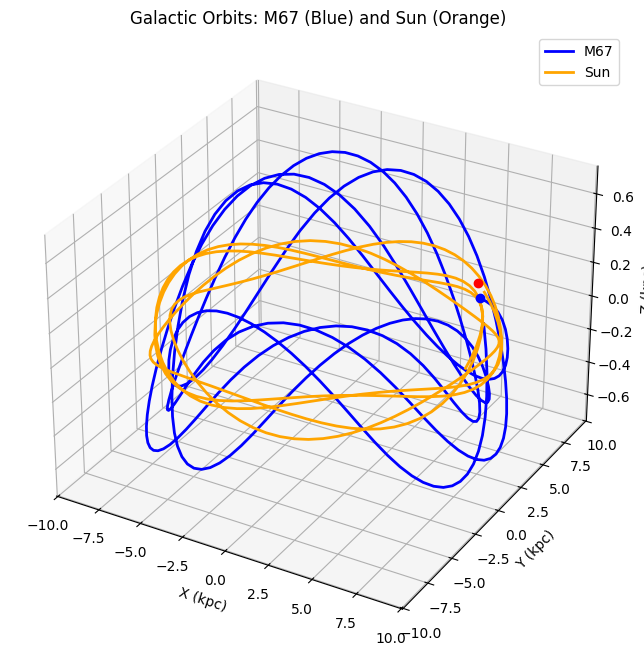

In [ ]:
fig = plt.figure(figsize=(10, 8))  #Initializes a 3D plot.
#Defines lines (orbit trails) and points (current position) for both M67 and Sun.
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(min(np.min(m67_x), np.min(sun_x)) - 1, max(np.max(m67_x), np.max(sun_x)) + 1)
ax.set_ylim(min(np.min(m67_y), np.min(sun_y)) - 1, max(np.max(m67_y), np.max(sun_y)) + 1)
ax.set_zlim(min(np.min(m67_z), np.min(sun_z)) - 0.2, max(np.max(m67_z), np.max(sun_z)) + 0.2)
ax.set_xlabel('X (kpc)')
ax.set_ylabel('Y (kpc)')
ax.set_zlabel('Z (kpc)')
ax.set_title('Galactic Orbits: M67 (Blue) and Sun (Orange)')

# Initialize lines and points
m67_line, = ax.plot([], [], [], lw=2, color='blue', label='M67')
sun_line, = ax.plot([], [], [], lw=2, color='orange', label='Sun')
m67_point, = ax.plot([], [], [], 'bo')
sun_point, = ax.plot([], [], [], 'ro')
ax.legend()

def init():
    m67_line.set_data([], [])
    m67_line.set_3d_properties([])
    m67_point.set_data([], [])
    m67_point.set_3d_properties([])

    sun_line.set_data([], [])
    sun_line.set_3d_properties([])
    sun_point.set_data([], [])
    sun_point.set_3d_properties([])
    return m67_line, sun_line, m67_point, sun_point

def update(frame):
    m67_line.set_data(m67_x[:frame], m67_y[:frame])
    m67_line.set_3d_properties(m67_z[:frame])
    m67_point.set_data([m67_x[frame]], [m67_y[frame]])
    m67_point.set_3d_properties([m67_z[frame]])

    sun_line.set_data(sun_x[:frame], sun_y[:frame])
    sun_line.set_3d_properties(sun_z[:frame])
    sun_point.set_data([sun_x[frame]], [sun_y[frame]])
    sun_point.set_3d_properties([sun_z[frame]])

    return m67_line, sun_line, m67_point, sun_point

ani = FuncAnimation(fig, update, frames=len(ts), init_func=init, interval=40, blit=False)
HTML(ani.to_jshtml())
#Each frame adds a new point to the orbit path.

# Orbital Analysis and Inference

This section interprets the galactic orbits of M67 and the Sun based on their integrated trajectories in the Milky Way's potential.


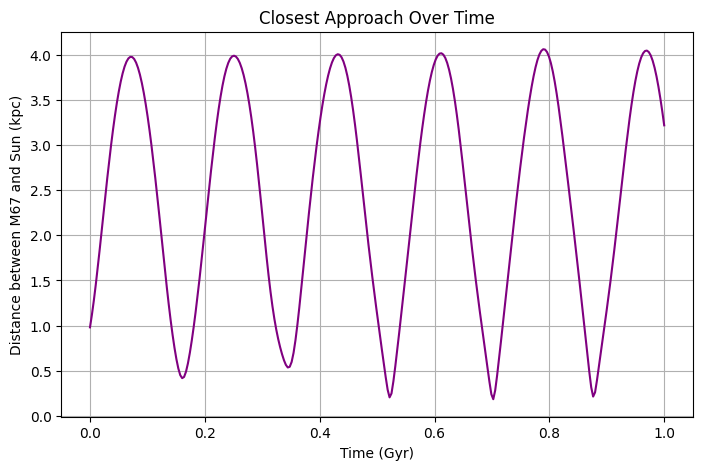

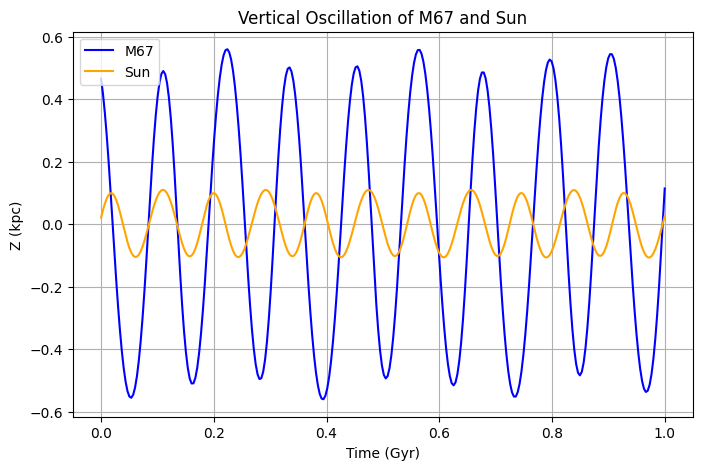

Orbital Summary:
Minimum distance between M67 and Sun: 0.18 kpc
M67 Orbital Radius: min = 7.71 kpc, max = 9.32 kpc, eccentricity = 0.094
Sun Orbital Radius: min = 7.92 kpc, max = 9.17 kpc, eccentricity = 0.073


In [ ]:
from astropy.constants import kpc
from astropy.coordinates import CartesianRepresentation

# Convert positions into arrays (in kpc)
x1, y1, z1 = np.array(m67_orb.x(ts)), np.array(m67_orb.y(ts)), np.array(m67_orb.z(ts))
x2, y2, z2 = np.array(sun_orb.x(ts)), np.array(sun_orb.y(ts)), np.array(sun_orb.z(ts))

# Compute 3D distance between M67 and Sun
distances = np.sqrt((x1 - x2)**2 + (y1 - y2)**2 + (z1 - z2)**2)

# Plot 1: Distance vs Time
plt.figure(figsize=(8.15, 5))
plt.plot(ts.value, distances, color='purple')
plt.xlabel("Time (Gyr)")
plt.ylabel("Distance between M67 and Sun (kpc)")
plt.title("Closest Approach Over Time")
plt.grid(True)
plt.show()
print("\n")
# Plot 2: Z vs Time (Vertical Oscillation)
plt.figure(figsize=(8, 5))
plt.plot(ts.value, z1, label="M67", color='blue')
plt.plot(ts.value, z2, label="Sun", color='orange')
plt.xlabel("Time (Gyr)")
plt.ylabel("Z (kpc)")
plt.title("Vertical Oscillation of M67 and Sun")
plt.legend()
plt.grid(True)
plt.show()

# Compute Orbital Parameters
r1 = np.sqrt(x1**2 + y1**2 + z1**2)
r2 = np.sqrt(x2**2 + y2**2 + z2**2)

ecc_m67 = (np.max(r1) - np.min(r1)) / (np.max(r1) + np.min(r1))
ecc_sun = (np.max(r2) - np.min(r2)) / (np.max(r2) + np.min(r2))

print("Orbital Summary:")
print(f"Minimum distance between M67 and Sun: {np.min(distances):.2f} kpc")
print(f"M67 Orbital Radius: min = {np.min(r1):.2f} kpc, max = {np.max(r1):.2f} kpc, eccentricity = {ecc_m67:.3f}")
print(f"Sun Orbital Radius: min = {np.min(r2):.2f} kpc, max = {np.max(r2):.2f} kpc, eccentricity = {ecc_sun:.3f}")


###Closest Approach
- **Minimum distance between M67 and the Sun:** ~0.18 kpc (~587 light-years)
- This proximity supports hypotheses that the Sun may have originated from a cluster like M67.

###Orbital Radii
- **M67 Orbit Radius:** 7.71 – 9.32 kpc
- **Sun Orbit Radius:** 7.92 – 9.17 kpc
- Both objects orbit at a similar average distance from the Galactic center, indicating shared dynamical environments.

### Eccentricity
- **M67 eccentricity:** 0.094
- **Sun eccentricity:** 0.073
- Nearly circular orbits suggest stable disk membership and minimal radial migration.




# Interpretation & Results

We observe the following:
- The Sun and M67 follow different but intersecting spiral orbits in the Galactic disk.
- The 3D plots reveal slight vertical oscillations about the Galactic plane.
- M67 has a more perturbed orbit compared to the Sun, suggesting different formation or migration history.

###  Z-displacement (Vertical Oscillation)
- Both objects show sinusoidal motion above and below the Galactic plane.
- This oscillation provides insights into how they interact with the Galactic disk over time.

##  Inference

- The Sun and M67 have overlapping, low-eccentricity orbits in the Galactic disk.
- Their similar galactocentric radii and vertical motion imply they may have co-evolved or at least been dynamically associated.
- These insights support studies of solar siblings and the dynamical history of the Milky Way disk.


## Conclusion and Future Work

### Conclusion

In this project, we have simulated and visualized the galactic orbits of the open cluster M67 and the Sun using six-dimensional phase-space data derived from Gaia observations. The orbital integration was performed within the Milky Way’s gravitational potential using the `galpy` library and the MWPotential2014 model.

Our results demonstrate that M67 and the Sun, while both orbiting the Galactic center, follow distinct trajectories. The visualization of their orbits in both two and three dimensions allowed for a comparative analysis of their kinematics over a period of 1 Gyr. The study also highlights the utility of orbit modeling in galactic dynamics and supports the hypothesis that although M67 and the Sun may share similar galactic environments, their orbital paths differ significantly in orientation and amplitude.

### Future Work

Several extensions of this work can be pursued to derive deeper insights:

- The orbital integration can be extended backward in time to investigate whether M67 and the Sun may have had a common origin or close encounter in the past.
- The analysis can be generalized to include other open clusters and field stars to identify dynamical associations using similar modeling techniques.
- Incorporation of Gaia astrometric uncertainties via Monte Carlo sampling could quantify the robustness of the orbital predictions and establish confidence intervals for dynamical parameters.
- Cross-referencing chemical abundance data with dynamical properties could provide constraints on the likelihood of common formation scenarios.
- A statistical or machine learning approach could be employed to classify stars based on their orbital characteristics in multi-dimensional phase space.

These directions would enhance the scientific relevance of the project and contribute to ongoing studies in galactic archaeology and stellar population dynamics.


# References

1. Gaia Collaboration, Brown, A. G. A., Vallenari, A., et al. (2021). *Gaia Early Data Release 3: Summary of the contents and survey properties.* A&A, 649, A1. https://doi.org/10.1051/0004-6361/202039657

2. Bovy, J. (2015). *galpy: A python Library for Galactic Dynamics.* The Astrophysical Journal Supplement Series, 216(2), 29. https://doi.org/10.1088/0067-0049/216/2/29

3. Soubiran, C., et al. (2018). *The Gaia radial velocity sample: kinematic structure of the Milky Way disk.* Astronomy & Astrophysics, 616, A7.

4. Schönrich, R., Binney, J., & Dehnen, W. (2010). *Local kinematics and the local standard of rest.* Monthly Notices of the Royal Astronomical Society, 403(4), 1829–1833.

5. galpy Documentation: https://docs.galpy.org

6. Gaia Archive: https://gea.esac.esa.int/archive/